# Previsão do preço de hospedagem em AirBnb

## A base de dados

Significado de cada coluna (dicionário de dados):

- `id`: identificação única de cada anúncio
- `host_id`: identificação única de cada anunciante
- `host_name`: primeiro nome de cada anunciante
- `neighbourhood_cleansed`: bairro
- `neighbourhood_group`: região
- `latitude`
- `longitude`
- `room_type`: tipo de hospedagem
- `accommodates`: hóspedes
- `bathrooms`: banheiros
- `bathrooms_text`: tipo de banheiro
- `bedrooms`: número de quartos
- `beds`: número de camas
- `amenities`: lista de comodidades oferecidas
- `price`: preço por noite em moeda local
- `minimum_nights`: mínimo de noites
- `maximum_nights`: máximo de noites
- `review_scores_rating`: avaliação de acordo com usuários do site
- `month`: mês quando o anúncio foi obtido da plataforma do AirBnb pelo Inside AirBnb
- `n_amenities`: número de comodidades oferecidas

In [1]:
import pandas as pd

BASE = "./dados/dados_inside_airbnb_2023.parquet"

dados_iniciais = pd.read_parquet(BASE)

dados_iniciais.head()

,id,host_id,host_name,neighbourhood_cleansed,neighbourhood_group,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,review_scores_rating,month,n_amenities
0,17878,68997,Matthias,Copacabana,Zona Sul,-22.96599,-43.17940,Entire home/apt,5,1.0,private,NaN,2.0,[],1357.0,5,28,4.70,12,10.0
1,25026,102840,Viviane,Copacabana,Zona Sul,-22.97735,-43.19105,Entire home/apt,3,1.0,private,NaN,1.0,[],865.0,2,60,4.72,12,10.0
2,35764,153691,Patricia Miranda & Paulo,Copacabana,Zona Sul,-22.98107,-43.19136,Entire home/apt,2,1.5,private,NaN,1.0,[],373.0,3,15,4.90,12,10.0
3,326205,1603206,Bob,Copacabana,Zona Sul,-22.96825,-43.18237,Entire home/apt,4,1.0,private,NaN,1.0,[],366.0,3,180,4.57,12,10.0
4,326575,1668565,Maria José,Copacabana,Zona Sul,-22.97696,-43.18933,Entire home/apt,5,2.0,private,NaN,3.0,[],368.0,4,60,4.81,12,10.0


In [2]:
dados_iniciais.tail()

,id,host_id,host_name,neighbourhood_cleansed,neighbourhood_group,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,review_scores_rating,month,n_amenities
75749,795777456524737382,490744881,Leonaldo,Copacabana,Zona Sul,-22.964420,-43.173516,Entire home/apt,6,1.0,private,2.0,3.0,"[""Wifi"", ""TV"", ""Kitchen"", ""Washer"", ""Refrigera...",392.0,3,365,5.00,6,5.0
75750,877519416246655615,511728723,Liliana,Copacabana,Zona Sul,-22.963801,-43.176689,Entire home/apt,2,1.0,private,1.0,1.0,"[""Luggage dropoff allowed"", ""Iron"", ""Oven"", ""G...",180.0,5,1125,NaN,6,37.0
75751,789962789847835221,108108055,Maria Angela,Copacabana,Zona Sul,-22.973970,-43.185760,Entire home/apt,4,1.0,private,1.0,1.0,"[""Iron"", ""Toaster"", ""Beach access"", ""Gas stove...",250.0,2,365,4.81,6,39.0
75752,866699455348990065,398674687,Taisa,Copacabana,Zona Sul,-22.963147,-43.175318,Entire home/apt,4,1.0,private,1.0,1.0,"[""Air conditioning"", ""TV"", ""Kitchen"", ""Wifi"", ...",160.0,3,365,NaN,6,5.0
75753,884077369420907708,38364611,Maria,Copacabana,Zona Sul,-22.970938,-43.187236,Entire home/apt,4,1.0,private,1.0,2.0,"[""Dedicated workspace"", ""Security cameras on p...",253.0,1,365,NaN,6,8.0


## Entendendo os dados

In [3]:
dados_iniciais.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75754 entries, 0 to 75753
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      75754 non-null  int64  
 1   host_id                 75754 non-null  int64  
 2   host_name               75747 non-null  object 
 3   neighbourhood_cleansed  75754 non-null  object 
 4   neighbourhood_group     75754 non-null  object 
 5   latitude                75754 non-null  float64
 6   longitude               75754 non-null  float64
 7   room_type               75754 non-null  object 
 8   accommodates            75754 non-null  int64  
 9   bathrooms               75754 non-null  float64
 10  bathrooms_text          75754 non-null  object 
 11  bedrooms                35956 non-null  float64
 12  beds                    75754 non-null  float64
 13  amenities               75754 non-null  object 
 14  price                   75754 non-null

- tipos de dados fazem sentido
- há valores ausentes -> **preparação para modelos**

In [4]:
# retirando colunas que não serão interessantes para o estudo
dados_iniciais = dados_iniciais.drop(columns=["id", "host_id", "host_name"])

dados_iniciais.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75754 entries, 0 to 75753
Data columns (total 17 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   neighbourhood_cleansed  75754 non-null  object 
 1   neighbourhood_group     75754 non-null  object 
 2   latitude                75754 non-null  float64
 3   longitude               75754 non-null  float64
 4   room_type               75754 non-null  object 
 5   accommodates            75754 non-null  int64  
 6   bathrooms               75754 non-null  float64
 7   bathrooms_text          75754 non-null  object 
 8   bedrooms                35956 non-null  float64
 9   beds                    75754 non-null  float64
 10  amenities               75754 non-null  object 
 11  price                   75754 non-null  float64
 12  minimum_nights          75754 non-null  int64  
 13  maximum_nights          75754 non-null  int64  
 14  review_scores_rating    58284 non-null

### Visualizações

#### Mapas

In [5]:
import geopandas

BASE_BAIRROS = "./dados/bairros_e_regioes.geojson"

dados_bairros = geopandas.read_file(BASE_BAIRROS)
dados_bairros.head()

,neighbourhood,neighbourhood_group,geometry
0,Paquetá,Paquetá,"MULTIPOLYGON Z (((-43.10567 -22.74888 0.00000,..."
1,Freguesia (Ilha),Ilha do Governador,"MULTIPOLYGON Z (((-43.17170 -22.77661 0.00000,..."
2,Bancários,Ilha do Governador,"MULTIPOLYGON Z (((-43.18915 -22.78318 0.00000,..."
3,Galeão,Ilha do Governador,"MULTIPOLYGON Z (((-43.22804 -22.78374 0.00000,..."
4,Portuguesa,Ilha do Governador,"MULTIPOLYGON Z (((-43.20763 -22.79498 0.00000,..."


<Axes: >

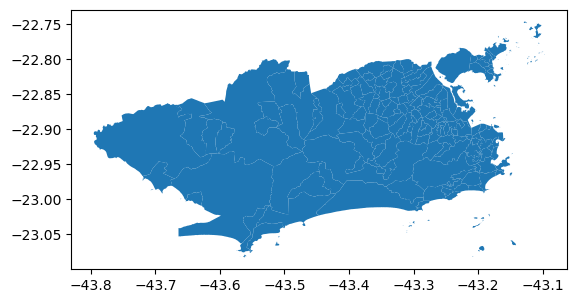

In [6]:
dados_bairros.plot()

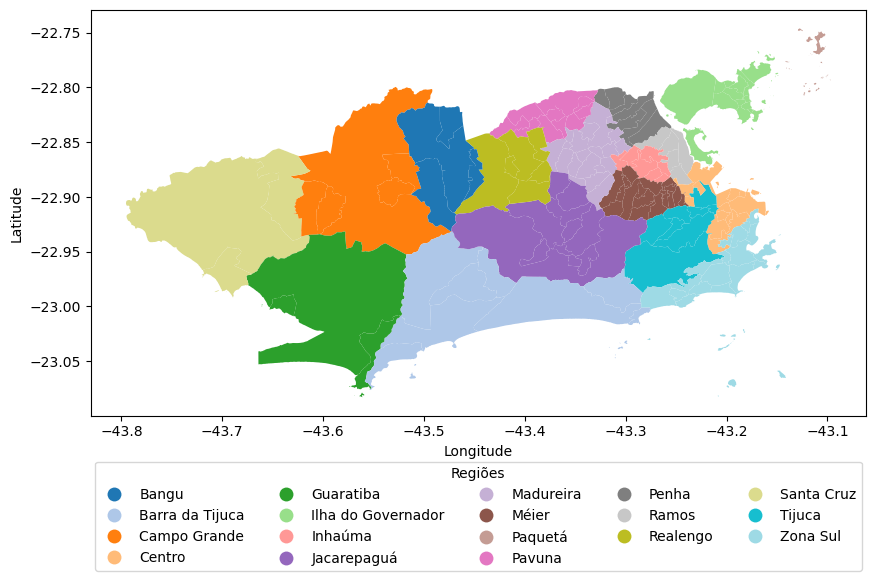

In [7]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1, figsize=(10, 10))

configuracao_legenda = {
    "title": "Regiões",
    "loc": "lower center",
    "bbox_to_anchor": (0.5, -0.4),
    "ncol": 5,
}

dados_bairros.plot(
    column="neighbourhood_group",
    legend=True,
    cmap="tab20",
    ax=ax,
    legend_kwds=configuracao_legenda,
)

ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

plt.show()

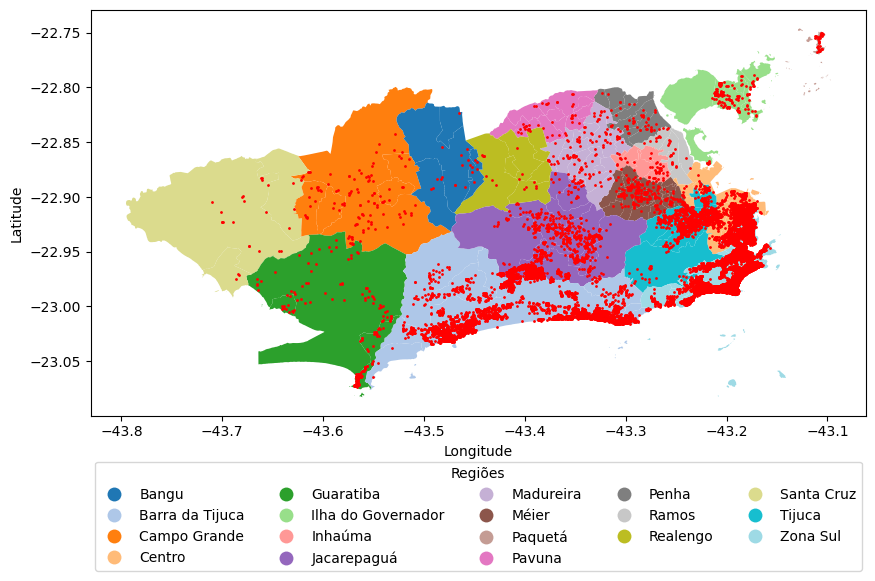

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

configuracao_legenda = {
    "title": "Regiões",
    "loc": "lower center",
    "bbox_to_anchor": (0.5, -0.4),
    "ncol": 5,
}

dados_bairros.plot(
    column="neighbourhood_group",
    legend=True,
    cmap="tab20",
    ax=ax,
    legend_kwds=configuracao_legenda,
)

ax.scatter("longitude", "latitude", data=dados_iniciais.query("month == 12"), s=1, color="red")

ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

plt.show()

In [9]:
import folium

centro_mapa = [
    dados_iniciais.query("month==12")["latitude"].mean(),
    dados_iniciais.query("month==12")["longitude"].mean(),
]

mapa = folium.Map(
    location=centro_mapa,
    zoom_start=10,
    tiles="CartoDB positron",
    attr="wherever",
)

for index, row in dados_bairros.iterrows():
    sim_geo = geopandas.GeoSeries(row["geometry"]).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j)
    folium.Popup(row["neighbourhood"]).add_to(geo_j)
    geo_j.add_to(mapa)

for index, row in dados_iniciais.query("month==12").iterrows():
    folium.CircleMarker(
        [row["latitude"], row["longitude"]],
        radius=1,
        color="red",
        fill=True,
        fill_color="red",
        fill_opacity=0.5,
    ).add_to(mapa)

mapa

In [10]:
from folium import plugins

mapa = folium.Map(
    location=centro_mapa,
    zoom_start=11,
    tiles="CartoDB positron",
    attr="wherever",
)

for index, row in dados_bairros.iterrows():
    sim_geo = geopandas.GeoSeries(row["geometry"]).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j)
    folium.Popup(row["neighbourhood"]).add_to(geo_j)
    geo_j.add_to(mapa)

# add heatmap
mapa.add_child(
    plugins.HeatMap(
        data=dados_iniciais.query("month==12")[["latitude", "longitude"]], radius=12
    )
)

mapa

## Análise exploratória

- entender a distribuição dos valores (alvo e variáveis)

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

<Axes: xlabel='price', ylabel='Count'>

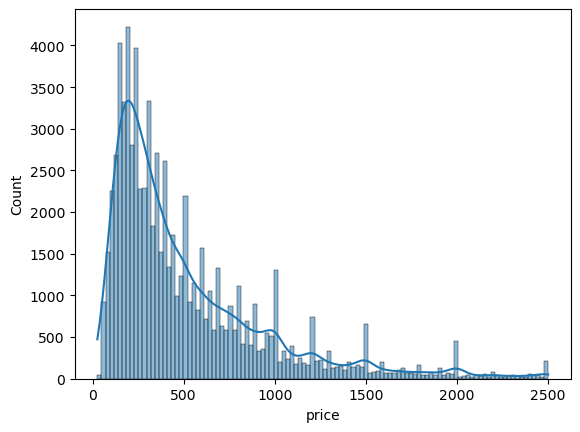

In [12]:
sns.histplot(data=dados_iniciais, x="price", kde=True)

<Axes: xlabel='price'>

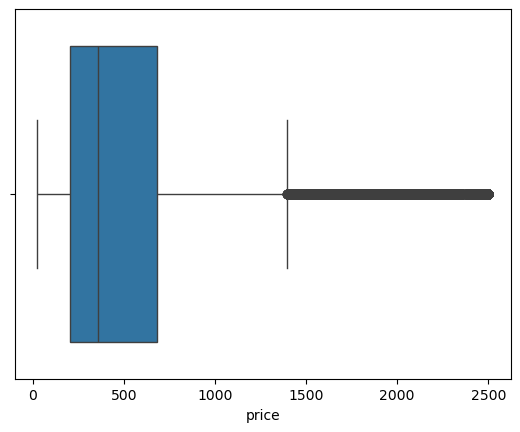

In [13]:
sns.boxplot(data=dados_iniciais, x="price", orient="h")

In [14]:
with pd.option_context("float_format", "{:.2f}".format):
    display(dados_iniciais.describe())

,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating,month,n_amenities
count,75754.00,75754.00,75754.00,75754.00,35956.00,75754.00,75754.00,75754.00,75754.00,58284.00,75754.00,75754.00
mean,-22.97,-43.25,3.43,1.37,1.52,2.02,515.39,2.53,474.18,4.76,9.13,18.19
std,0.03,0.10,1.41,0.61,0.73,1.06,442.50,1.47,455.75,0.50,2.47,11.56
min,-23.07,-43.71,1.00,0.00,1.00,1.00,26.00,1.00,1.00,0.00,6.00,1.00
25%,-22.98,-43.28,2.00,1.00,1.00,1.00,204.00,1.00,45.00,4.72,6.00,10.00
50%,-22.97,-43.19,4.00,1.00,1.00,2.00,359.00,2.00,365.00,4.91,9.00,11.00
75%,-22.95,-43.19,4.00,2.00,2.00,3.00,681.00,3.00,1125.00,5.00,12.00,27.00
max,-22.75,-43.10,6.00,13.00,25.00,5.00,2500.00,9.00,1125.00,5.00,12.00,48.00


In [15]:
colunas_analise_grafica = [
    "accommodates",
    "beds",
    "minimum_nights",
    "maximum_nights",
    "n_amenities",
]

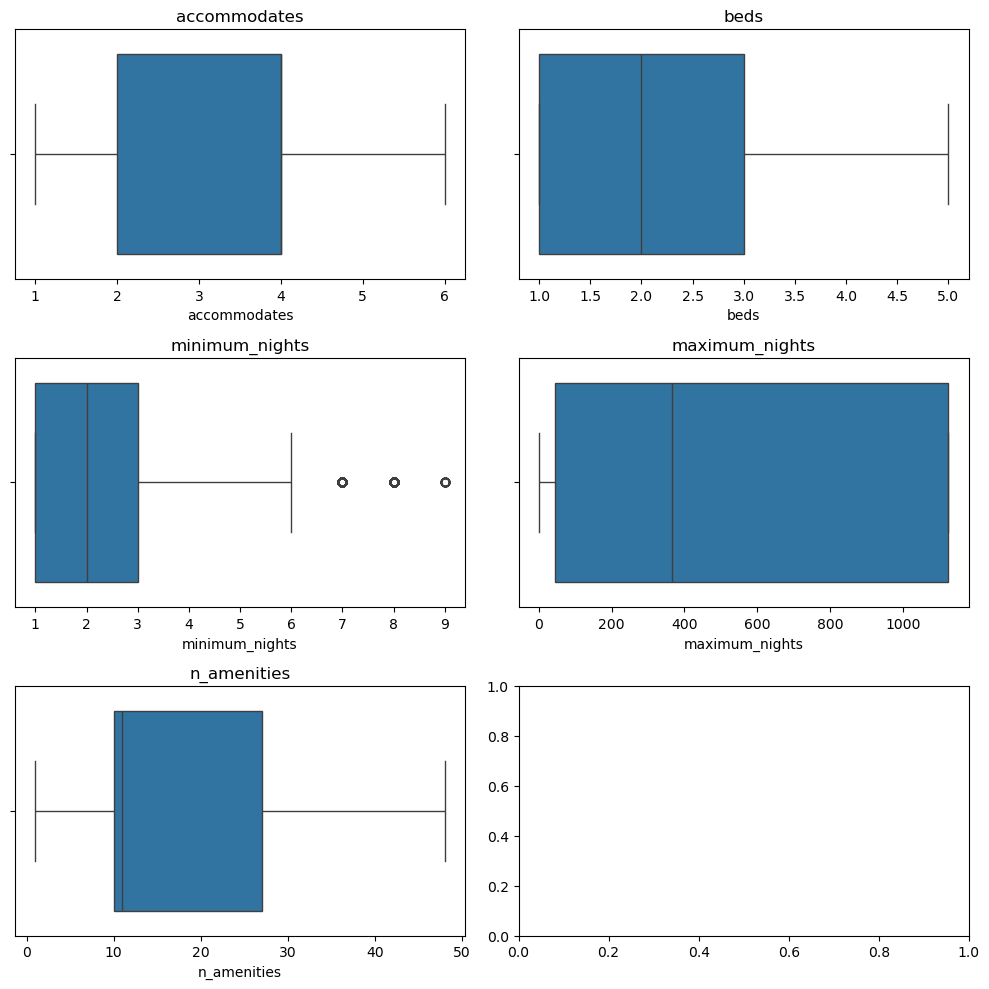

In [16]:
fig, axs = plt.subplots(3, 2, figsize=(10, 10))

for coluna, ax in zip(colunas_analise_grafica, axs.flatten()):
    sns.boxplot(data=dados_iniciais, x=coluna, ax=ax, orient="h")
    ax.set_title(coluna)

plt.tight_layout()

plt.show()


E as variáveis categóricas?

In [17]:
dados_iniciais.describe(include="object")

,neighbourhood_cleansed,neighbourhood_group,room_type,bathrooms_text,amenities
count,75754,75754,75754,75754,75754
unique,154,18,4,2,45121
top,Copacabana,Zona Sul,Entire home/apt,private,[]
freq,23734,47504,57601,67027,27535


## Pré-processamento - Entendendo a ideia e a necessidade

- ajustar a escala dos dados para facilitar o funcionamento dos modelos
- transformar dados de texto em numéricos

Obs.: Não se faz o pré-processamento em toda a base. A seguir será feito em toda a base para fins didáticos, mais adiante vamos fazer da forma adequada para o modelo.

Vamos olhar as escalas das colunas numéricas mostradas acima.

Qual o papel das variáveis categóricas?

<Axes: xlabel='price', ylabel='room_type'>

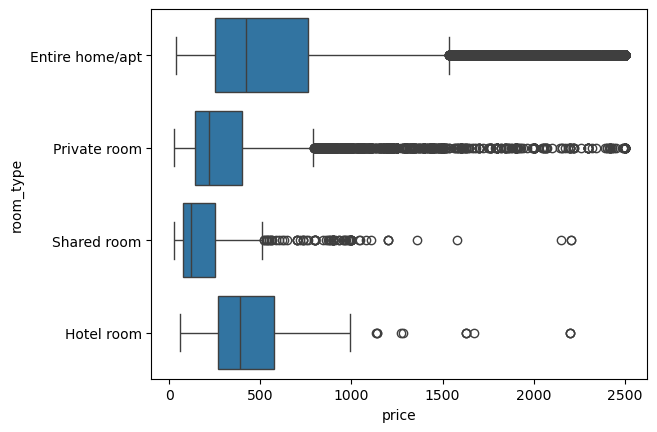

In [19]:
sns.boxplot(data=dados_iniciais, x="price", y="room_type")

In [20]:

# OFF
dados_processados = dados_processados.drop(columns=["neighbourhood_cleansed", "amenities"])
dados_iniciais = dados_iniciais.drop(columns=["neighbourhood_cleansed", "amenities"])

![onehot](./imagens/onehot.png)

In [21]:
from sklearn.preprocessing import OneHotEncoder

one_hot_encoder = OneHotEncoder(sparse_output=False)

# aplicar em todas as colunas não numéricas
colunas_categoricas = dados_processados.select_dtypes(include="object").columns

# aplicar encoder
dados_processados = pd.concat(
    [
        dados_processados.drop(columns=colunas_categoricas),
        pd.DataFrame(
            one_hot_encoder.fit_transform(dados_processados[colunas_categoricas]),
            columns=one_hot_encoder.get_feature_names_out(colunas_categoricas),
        ),
    ],
    axis=1,
)

with pd.option_context("display.max_columns", None):
    display(dados_processados.head())

,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating,month,n_amenities,neighbourhood_group_Bangu,neighbourhood_group_Barra da Tijuca,neighbourhood_group_Campo Grande,neighbourhood_group_Centro,neighbourhood_group_Guaratiba,neighbourhood_group_Ilha do Governador,neighbourhood_group_Inhaúma,neighbourhood_group_Jacarepaguá,neighbourhood_group_Madureira,neighbourhood_group_Méier,neighbourhood_group_Paquetá,neighbourhood_group_Pavuna,neighbourhood_group_Penha,neighbourhood_group_Ramos,neighbourhood_group_Realengo,neighbourhood_group_Santa Cruz,neighbourhood_group_Tijuca,neighbourhood_group_Zona Sul,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,bathrooms_text_private,bathrooms_text_shared
0,-22.96599,-43.17940,0.5,1.0,NaN,0.0,1357.0,1.5,-0.312037,4.70,12,-0.058824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
1,-22.97735,-43.19105,-0.5,1.0,NaN,-0.5,865.0,0.0,-0.282407,4.72,12,-0.058824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
2,-22.98107,-43.19136,-1.0,1.5,NaN,-0.5,373.0,0.5,-0.324074,4.90,12,-0.058824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
3,-22.96825,-43.18237,0.0,1.0,NaN,-0.5,366.0,0.5,-0.171296,4.57,12,-0.058824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
4,-22.97696,-43.18933,0.5,2.0,NaN,0.5,368.0,1.0,-0.282407,4.81,12,-0.058824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0


In [22]:
with pd.option_context("display.max_columns", None):
    display(dados_processados.tail())

,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating,month,n_amenities,neighbourhood_group_Bangu,neighbourhood_group_Barra da Tijuca,neighbourhood_group_Campo Grande,neighbourhood_group_Centro,neighbourhood_group_Guaratiba,neighbourhood_group_Ilha do Governador,neighbourhood_group_Inhaúma,neighbourhood_group_Jacarepaguá,neighbourhood_group_Madureira,neighbourhood_group_Méier,neighbourhood_group_Paquetá,neighbourhood_group_Pavuna,neighbourhood_group_Penha,neighbourhood_group_Ramos,neighbourhood_group_Realengo,neighbourhood_group_Santa Cruz,neighbourhood_group_Tijuca,neighbourhood_group_Zona Sul,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,bathrooms_text_private,bathrooms_text_shared
75749,-22.964420,-43.173516,1.0,1.0,2.0,0.5,392.0,0.5,0.000000,5.00,6,-0.352941,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
75750,-22.963801,-43.176689,-1.0,1.0,1.0,-0.5,180.0,1.5,0.703704,NaN,6,1.529412,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
75751,-22.973970,-43.185760,0.0,1.0,1.0,-0.5,250.0,0.0,0.000000,4.81,6,1.647059,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
75752,-22.963147,-43.175318,0.0,1.0,1.0,-0.5,160.0,0.5,0.000000,NaN,6,-0.352941,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
75753,-22.970938,-43.187236,0.0,1.0,1.0,0.0,253.0,-0.5,0.000000,NaN,6,-0.176471,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0


In [23]:
dados_processados.filter(like="room_type").head(20)

,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,1.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0
5,0.0,0.0,1.0,0.0
6,0.0,0.0,1.0,0.0
7,1.0,0.0,0.0,0.0
8,0.0,0.0,1.0,0.0
9,0.0,0.0,1.0,0.0


- As variáveis numéricas precisam ter suas escalas ajustadas.

- Ainda tem a questão dos dados ausentes.

- Tudo isso são etapas que vão se juntando como uma linha de montagem -> pipeline.

Vamos ver nosso **código final**.

Scikit-Learn

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, RobustScaler
from sklearn.impute import SimpleImputer


def pre_processamento(X, y):
    variaveis_numericas = X.select_dtypes(include=["int64", "float64"]).columns
    variaveis_categoricas = X.select_dtypes(include=["object"]).columns

    transformacao_numericas = Pipeline(
        steps=[
            ("imputacao", SimpleImputer(strategy="median")),
            ("escala", RobustScaler()),
        ]
    )

    transformacao_categoricas = Pipeline(
        steps=[
            (
                "imputacao",
                SimpleImputer(strategy="most_frequent", fill_value="missing"),
            ),
            ("onehot", OneHotEncoder(handle_unknown="ignore")),
        ]
    )

    transformacoes = ColumnTransformer(
        transformers=[
            ("numericas", transformacao_numericas, variaveis_numericas),
            ("categoricas", transformacao_categoricas, variaveis_categoricas),
        ]
    )

    return transformacoes

## Pipeline - uma linha de montagem para treinar modelos

### Qual o tipo de problema?

Qual o tipo de problema que temos?

Resposta: **regressão**. Vamos discutir isso.

### O nosso pipeline

![geral](./imagens/diagram01.png)

Entendendo a divisão:

![cv](./imagens/diagram03.png)

Métricas para comparar os modelos:

- R quadrado ($R^2$)
- MAE (*Mean Absolute Error*) - Erro absoluto médio
- ...


In [24]:
dados_iniciais.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75754 entries, 0 to 75753
Data columns (total 15 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   neighbourhood_group   75754 non-null  object 
 1   latitude              75754 non-null  float64
 2   longitude             75754 non-null  float64
 3   room_type             75754 non-null  object 
 4   accommodates          75754 non-null  int64  
 5   bathrooms             75754 non-null  float64
 6   bathrooms_text        75754 non-null  object 
 7   bedrooms              35956 non-null  float64
 8   beds                  75754 non-null  float64
 9   price                 75754 non-null  float64
 10  minimum_nights        75754 non-null  int64  
 11  maximum_nights        75754 non-null  int64  
 12  review_scores_rating  58284 non-null  float64
 13  month                 75754 non-null  int64  
 14  n_amenities           75754 non-null  float64
dtypes: float64(8), int6

In [25]:
X = dados_iniciais.drop(columns="price")
y = dados_iniciais["price"]

In [26]:
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression, SGDRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor


modelos = {
    "DummyRegressor": DummyRegressor(),
    "LinearRegression": LinearRegression(),
    "SGDRegressor": SGDRegressor(),
    "KNeighborsRegressor": KNeighborsRegressor(),
    "DecisionTreeRegressor": DecisionTreeRegressor(),
    "XGBRegressor": XGBRegressor(),
}

modelos

{'DummyRegressor': DummyRegressor(),
 'LinearRegression': LinearRegression(),
 'SGDRegressor': SGDRegressor(),
 'KNeighborsRegressor': KNeighborsRegressor(),
 'DecisionTreeRegressor': DecisionTreeRegressor(),
 'XGBRegressor': XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)}

In [27]:

# OFF
import numpy as np
from sklearn.compose import TransformedTargetRegressor

def log_transform(x):
    return np.log(x)


def exp_transform(x):
    return np.exp(x)


modelos = {
    k: TransformedTargetRegressor(
        regressor=v, func=log_transform, inverse_func=exp_transform
    )
    for k, v in modelos.items()
}

In [ ]:
from sklearn.model_selection import cross_validate, KFold


def executa_pipeline(modelo, X, y):

    transformacoes = pre_processamento(X, y)

    divisoes = KFold(n_splits=5, shuffle=True, random_state=42)

    pipeline_modelo = Pipeline(
        steps=[("transformacoes", transformacoes), ("regressor", modelo)]
    )

    metricas = cross_validate(
        pipeline_modelo,
        X,
        y,
        cv=divisoes,
        scoring=(
            "r2",
            "neg_mean_absolute_error",
        ),
        n_jobs=-1,  # usar todo o processamento da máquina
        verbose=0,
    )

    return pipeline_modelo, metricas


In [28]:
resultados = {
    nome_modelo: [*executa_pipeline(modelo, X, y)]
    for nome_modelo, modelo in modelos.items()
}


In [29]:

# OFF
from funcoes import organiza_resultados

df_resultados = organiza_resultados(
    {modelo: resultado[1] for modelo, resultado in resultados.items()}
)

# resultados

In [30]:
df_resultados

,model,fit_time,score_time,test_r2,test_neg_mean_absolute_error,time_seconds
0,DummyRegressor,0.185126,0.021679,-0.092951,-296.326656,0.206805
1,DummyRegressor,0.196753,0.019557,-0.098766,-304.44812,0.21631
2,DummyRegressor,0.180122,0.027019,-0.101799,-306.74,0.207141
3,DummyRegressor,0.189154,0.018988,-0.093879,-303.70938,0.208142
4,DummyRegressor,0.16786,0.024753,-0.109632,-307.977617,0.192613
5,LinearRegression,0.342946,0.025501,0.313681,-223.947797,0.368447
6,LinearRegression,0.345146,0.026388,0.294837,-232.869558,0.371534
7,LinearRegression,0.338788,0.033734,0.299491,-230.927101,0.372522
8,LinearRegression,0.327255,0.033734,0.297326,-229.92492,0.360989
9,LinearRegression,0.329092,0.025226,0.303717,-232.681839,0.354318


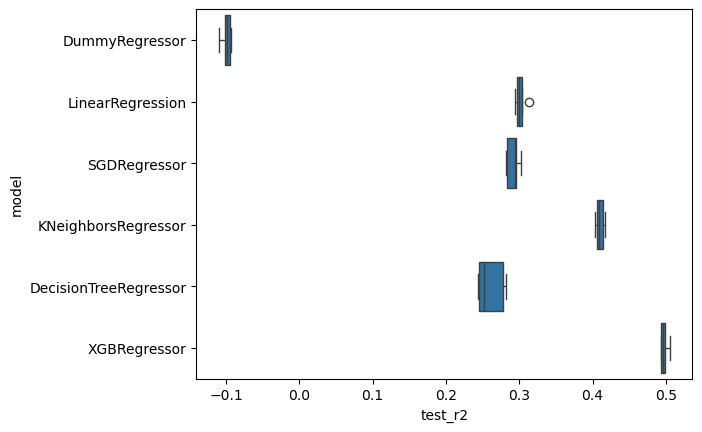

In [31]:
fig, ax = plt.subplots()

sns.boxplot(data=df_resultados, y="model", x="test_r2", ax=ax)

plt.show()

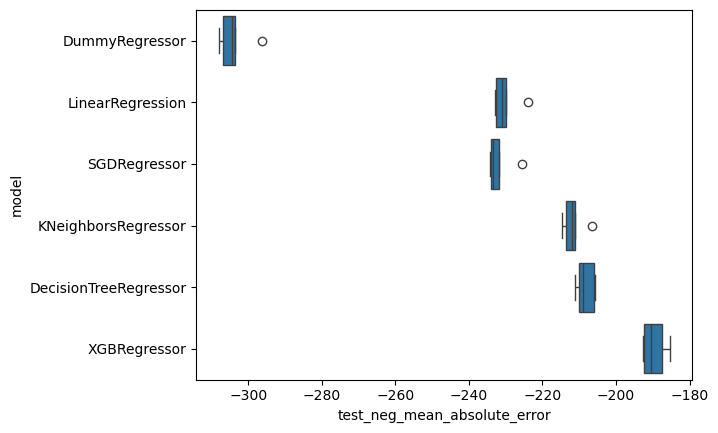

In [32]:
fig, ax = plt.subplots()

sns.boxplot(data=df_resultados, y="model", x="test_neg_mean_absolute_error", ax=ax)

plt.show()

In [33]:
pipeline_escolhido = resultados["XGBRegressor"][0]
pipeline_escolhido

Pipeline(steps=[('transformacoes',
                 ColumnTransformer(transformers=[('numericas',
                                                  Pipeline(steps=[('imputacao',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('escala',
                                                                   RobustScaler())]),
                                                  Index(['latitude', 'longitude', 'accommodates', 'bathrooms', 'bedrooms',
       'beds', 'minimum_nights', 'maximum_nights', 'review_scores_rating',
       'month', 'n_amenities'],
      dtype='object')),
                                                 ('catego...
                                                                   grow_policy=None,
                                                                   importance_type=None,
                                                                   interaction_constraints=None,
                                                                   learning_rate=None,
                                                                   max_bin=None,
                                                                   max_cat_threshold=None,
                                                                   max_cat_to_onehot=None,
                                                                   max_delta_step=None,
                                                                   max_depth=None,
                                                                   max_leaves=None,
                                                                   min_child_weight=None,
                                                                   missing=nan,
                                                                   monotone_constraints=None,
                                                                   multi_strategy=None,
                                                                   n_estimators=None,
                                                                   n_jobs=None,
                                                                   num_parallel_tree=None,
                                                                   random_state=None, ...)))])

### Validação

In [35]:
y_pred = pipeline_escolhido.predict(X)

previsoes = dados_iniciais.copy()
previsoes["preco_previsto"] = y_pred
previsoes["preco_diferenca"] = previsoes["price"] - previsoes["preco_previsto"]
previsoes.head()

,neighbourhood_group,latitude,longitude,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating,month,n_amenities,preco_previsto,preco_diferenca
0,Zona Sul,-22.96599,-43.17940,Entire home/apt,5,1.0,private,NaN,2.0,1357.0,5,28,4.70,12,10.0,1326.684570,30.315430
1,Zona Sul,-22.97735,-43.19105,Entire home/apt,3,1.0,private,NaN,1.0,865.0,2,60,4.72,12,10.0,744.172058,120.827942
2,Zona Sul,-22.98107,-43.19136,Entire home/apt,2,1.5,private,NaN,1.0,373.0,3,15,4.90,12,10.0,378.804321,-5.804321
3,Zona Sul,-22.96825,-43.18237,Entire home/apt,4,1.0,private,NaN,1.0,366.0,3,180,4.57,12,10.0,379.053314,-13.053314
4,Zona Sul,-22.97696,-43.18933,Entire home/apt,5,2.0,private,NaN,3.0,368.0,4,60,4.81,12,10.0,443.006714,-75.006714


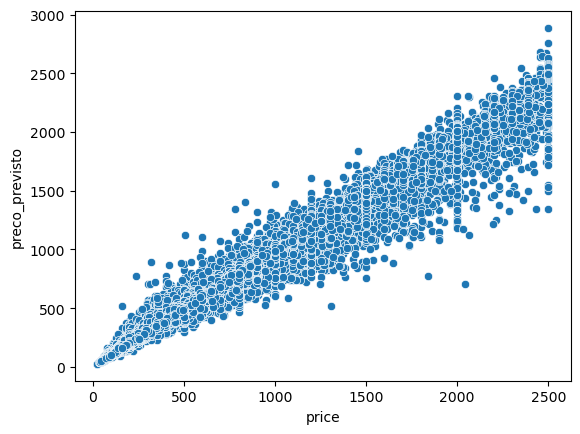

In [36]:
fig, ax = plt.subplots()

sns.scatterplot(data=previsoes, x="price", y="preco_previsto", ax=ax)

plt.show()

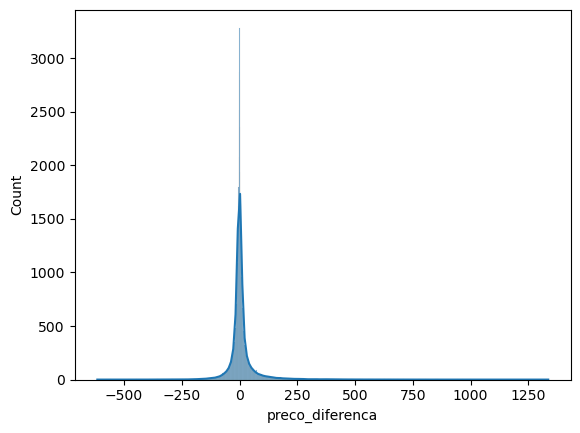

In [37]:
sns.histplot(data=previsoes, x="preco_diferenca", bins="auto", kde=True)

plt.show()

## Produção

In [38]:
import joblib

joblib.dump(pipeline_escolhido, "modelos/modelo_apresentacao.pkl", compress=3)

['modelos/modelo_apresentacao.pkl']